# ResNet 101 como backbone
Se evalúa el desempeño del uso de la mask_rcnn_X_101_32x8d_FPN_3x como backbone para el entrenamiento con el dataset TACO

Modelo adaptado de https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5

Se instalan Detectron2 y sus dependencias

In [ ]:
# Se instala constructor PyYAML para python
!pip install pyyaml==5.1

# Se instala versión 1.8 de pytorch por compatibilidad por detectron2 (Fuente: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# Se instala librería detectron2 compatible con pytorch 1.8
# Fuente: https://detectron2.readthedocs.io/tutorials/install.html 
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
exit(0)  #  Después de la instalación, se debe reiniciar el entorno de ejecución (Opción "restart runtime") 

     |████████████████████████████████| 276kB 36.3MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44091 sha256=fa2939092890b124afbca1d2d25df4754a3364fb0bf08b7311efeb8819a3038a
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 763.5MB 23kB/s 
     |████████████████████████████████| 17.3MB 193kB/s 
ERROR: torchtext 0.10.0 has requirement torch==1.9.0, but you'll have torch 1.8.0+cu101 which is incompatible.
  Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Succe

In [ ]:
# Se cargan las librerías de pytorch y se verifica que la version instalada sea la correcta
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.8")

1.8.0+cu101 True


In [ ]:
# Se cargan liberías basicas
# detectron2 
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

Agregamos el dataset TACO

In [ ]:
# Se descarga el conjunto de imagenes TACO almacenado en un drive público
!gdown --id 1CT6ws8MLyqkhMRmafMl6wuhqZ1lgFuLg #https://drive.google.com/file/d/1CT6ws8MLyqkhMRmafMl6wuhqZ1lgFuLg/view?usp=sharing

Downloading...
From: https://drive.google.com/uc?id=1CT6ws8MLyqkhMRmafMl6wuhqZ1lgFuLg
To: /content/TACO.zip
2.62GB [00:33, 77.6MB/s]


In [ ]:
# Descomprimimos el archivo
!unzip TACO.zip

Archive:  TACO.zip
   creating: data/
  inflating: data/all_image_urls.csv  
  inflating: data/annotations.json   
  inflating: data/annotations_unofficial.json  
   creating: data/batch_1/
   creating: data/batch_10/
  inflating: data/batch_10/000000.jpg  
  inflating: data/batch_10/000001.jpg  
  inflating: data/batch_10/000002.jpg  
  inflating: data/batch_10/000003.jpg  
  inflating: data/batch_10/000004.jpg  
  inflating: data/batch_10/000005.jpg  
  inflating: data/batch_10/000006.jpg  
  inflating: data/batch_10/000007.jpg  
  inflating: data/batch_10/000008.jpg  
  inflating: data/batch_10/000009.jpg  
  inflating: data/batch_10/000010.jpg  
  inflating: data/batch_10/000011.jpg  
  inflating: data/batch_10/000012.jpg  
  inflating: data/batch_10/000013.jpg  
  inflating: data/batch_10/000014.jpg  
  inflating: data/batch_10/000015.jpg  
  inflating: data/batch_10/000016.jpg  
  inflating: data/batch_10/000017.jpg  
  inflating: data/batch_10/000018.jpg  
  inflating: data/batc

In [ ]:
# Se descarga las liberías para generación del conjunto de entrenamiento, de pruebas y validación
!gdown --id 1SnfUBgpoo6N_k5bgjSW3PwmKV0ElXqVD #https://drive.google.com/file/d/1SnfUBgpoo6N_k5bgjSW3PwmKV0ElXqVD/view?usp=sharing

Downloading...
From: https://drive.google.com/uc?id=1SnfUBgpoo6N_k5bgjSW3PwmKV0ElXqVD
To: /content/split_dataset.py
100% 3.35k/3.35k [00:00<00:00, 2.95MB/s]


In [ ]:
# Se realiza la generación del conjunto de entrenamiento, de pruebas y validación
!python split_dataset.py --dataset_dir data --test_percentage 20 --val_percentage 0 --nr_trials 1

## Segmentación por instancias en TACO-1
Agrupando las imágenes en una sola clase denominada "Litter" la red detecta cualquier tipo de basura y la segmenta

In [ ]:
from detectron2.structures import BoxMode

# Se define la función para extraer las anotaciones del dataset
def get_TACO_1_dicts(im_dir, dataset):
    # Segun el dataset ingresado se carga el conjunto de entrenamiento, validacion o pruebas
    json_file = os.path.join(im_dir, dataset)
    with open(json_file) as f:
        data = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(data['images']):
        record = {}
        
        filename = os.path.join(im_dir, v["file_name"])
        
        # Se guardan los datos relevantes de cada imagen
        record["file_name"] = filename
        record["image_id"] = v["id"]
        record["height"] = v["height"]
        record["width"] = v["width"]
      
        objs = []
        # Se itera entre las anotaciones que corresponden a la imagen
        for anno in data["annotations"]:
            if anno["image_id"] == v["id"]:
                obj = {
                    "bbox": anno["bbox"],
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "segmentation": anno["segmentation"],
                    "category_id": 0,
                }
                objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [ ]:
# Finalmente se carga el conjunto de datos al repositorio de detectron para poder utilizarlo
for d in ["train", "test"]:
    # La funcion de registro nos exige un nombre de conjunto de datos y una función que devuelva un diccionario con su informacion relevante
    DatasetCatalog.register("TACO_1_" + d, lambda d=d: get_TACO_1_dicts("data","annotations_0_" + d + ".json"))
    MetadataCatalog.get("TACO_1_" + d).set(thing_classes=["Litter"])
TACO_1_metadata = MetadataCatalog.get("TACO_1_train")

Cargamos algunas imagenes de prueba para confirmar si los datos subidos son correctos

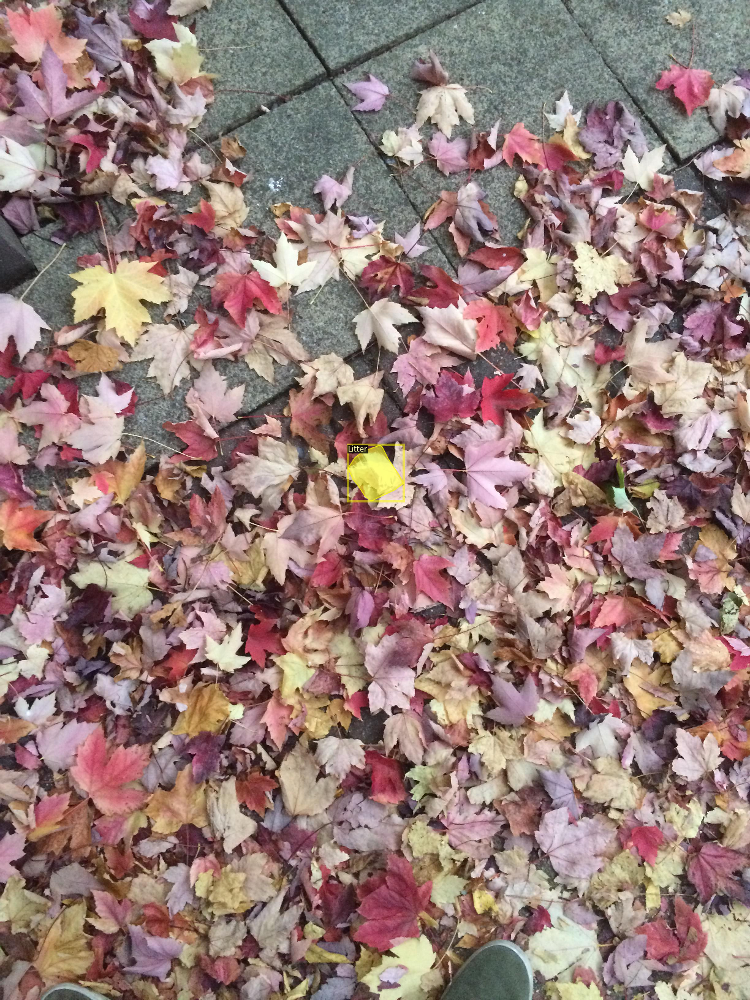

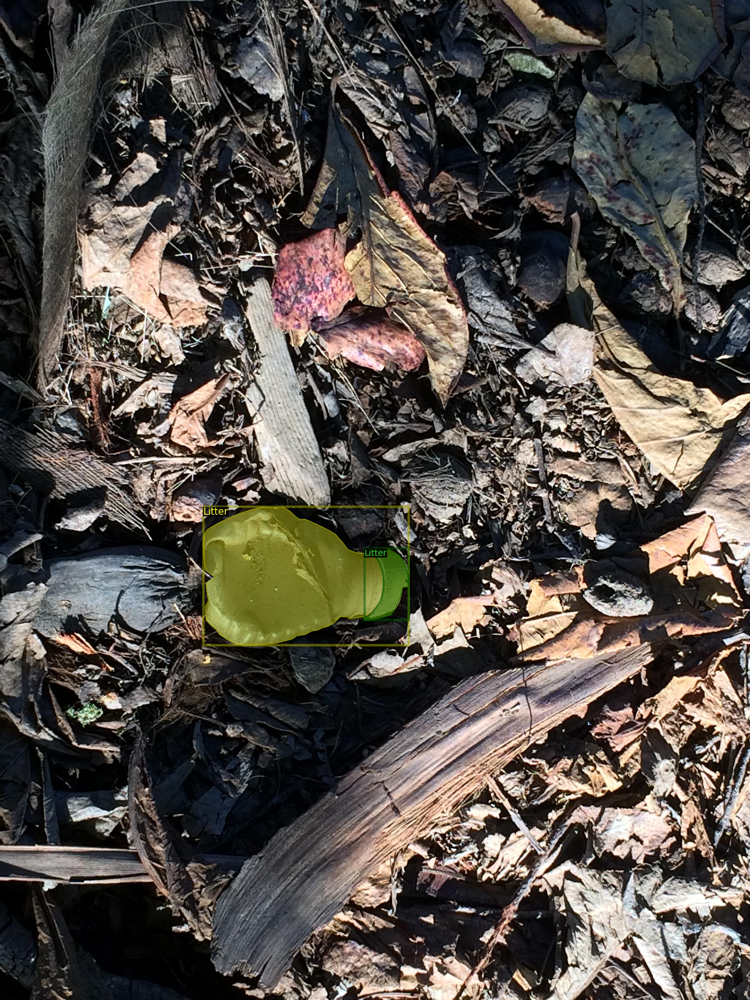

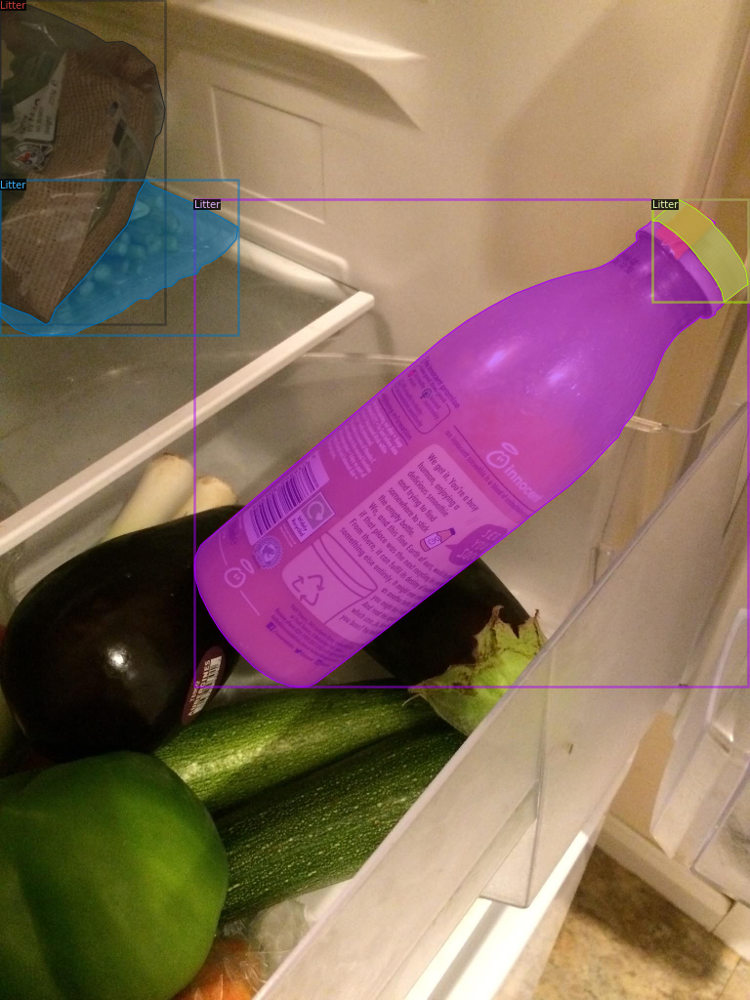

In [ ]:
# Invocación a la función del dataset para extraer sus imagenes y anotaciones
dataset_dicts = get_TACO_1_dicts("data","annotations_0_train.json")
# Se toman 3 muestras aleatorias
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=TACO_1_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

A continuación, se define la configuración de los parámetros a usar para el entrenamiento. En esta sección se modifican los backbones, epocas y regiones propuestas para la experimentacion.

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")) # Cargar el backbone elgido
cfg.DATASETS.TRAIN = ("TACO_1_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Cargar los pesos de la red preentrenada con COCO
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001  # learning rate
cfg.SOLVER.MAX_ITER = 2000    # numero de epocas
cfg.SOLVER.STEPS = []  
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # cantidad de regiones propuestas por imagen
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # una sola clase "Litter"


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[07/01 15:58:33 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_2d9806.pkl: 431MB [00:21, 19.7MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[07/01 15:58:59 d2.engine.train_loop]: Starting training from iteration 0
[07/01 15:59:28 d2.utils.events]:  eta: 0:46:16  iter: 19  total_loss: 1.934  loss_cls: 0.6919  loss_box_reg: 0.1618  loss_mask: 0.6932  loss_rpn_cls: 0.2865  loss_rpn_loc: 0.03953  time: 1.4136  data_time: 0.0673  lr: 1.9981e-05  max_mem: 6271M
[07/01 15:59:55 d2.utils.events]:  eta: 0:45:30  iter: 39  total_loss: 1.436  loss_cls: 0.4031  loss_box_reg: 0.1602  loss_mask: 0.6395  loss_rpn_cls: 0.07998  loss_rpn_loc: 0.01026  time: 1.3876  data_time: 0.0093  lr: 3.9961e-05  max_mem: 6271M
[07/01 16:00:25 d2.utils.events]:  eta: 0:44:51  iter: 59  total_loss: 0.9769  loss_cls: 0.2435  loss_box_reg: 0.1239  loss_mask: 0.5628  loss_rpn_cls: 0.04577  loss_rpn_loc: 0.01112  time: 1.4207  data_time: 0.0120  lr: 5.9941e-05  max_mem: 6271M
[07/01 16:00:54 d2.utils.events]:  eta: 0:44:52  iter: 79  total_loss: 0.9972  loss_cls: 0.1842  loss_box_reg: 0.1286  loss_mask: 0.4673  loss_rpn_cls: 0.06308  loss_rpn_loc: 0.03745  t

Observamos las curvas de entrenamiento tanto del loss global como de las distintas etapas (ROI, rpn, faster r-cnn, mask)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

Se configura el modelo para realizar las predicciones

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  #  ruta del modelo ya entrenado
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # configuración del límite de detección 
predictor = DefaultPredictor(cfg) # Se carga el DefaultPredictor() que permite hacer predicciones en imagenes individuales para pruebas

In [ ]:
# Funcion que lee los nombres de los archivos de prueba para realizar la validación
def get_TACO_filenames(img_dir):
  json_file = os.path.join(img_dir, "annotations_0_test.json")
  with open(json_file) as f:
    data = json.load(f)
  filenames = []
  for image in data['images']:
    filenames.append(os.path.join(img_dir,image['file_name']))
  return filenames

Probamos las predicciones con algunas imágenes del conjunto de prueba

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_TACO_filenames("data")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d)
    outputs = predictor(im) 
    v = Visualizer(im[:, :, ::-1],
                   metadata=TACO_1_metadata, 
                   scale=0.5,  
                   instance_mode=ColorMode.IMAGE_BW   
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

Por último, evaluamos la red con ayuda de la función `COCOEvaluator()` que nos devuelve las métricas seleccionadas.

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("TACO_1_test", ("bbox","segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "TACO_1_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[07/01 16:48:58 d2.evaluation.coco_evaluation]: 'TACO_1_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[07/01 16:48:58 d2.data.datasets.coco]: Converting annotations of dataset 'TACO_1_test' to COCO format ...)
[07/01 16:48:58 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[07/01 16:48:58 d2.data.datasets.coco]: Conversion finished, #images: 300, #annotations: 991
[07/01 16:48:58 d2.data.datasets.coco]: Caching COCO format annotations at './output/TACO_1_test_coco_format.json' ...
[07/01 16:48:58 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   Litter   | 991          |
|            |              |
[07/01 16:48:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[07/01 16:48:58 d2.data.common]: Serializing 300 elements

## Segmentación por instancias en TACO-10
Se agrupan las imágenes en 10 clases haciendo que la red identifique y segmente la basura para luego clasificarla en una de las categorías.

Se descarga el archivo map_10.csv donde se encuentra la relación entre las 60 clases del dataset y las 10 superclases en las que se agruparan para este entrenamiento.

In [ ]:
!gdown --id 1ATP41SZ52M736-UzxQ6X_g5PbVfSHsNu #https://drive.google.com/file/d/1ATP41SZ52M736-UzxQ6X_g5PbVfSHsNu/view?usp=sharing

Downloading...
From: https://drive.google.com/uc?id=1ATP41SZ52M736-UzxQ6X_g5PbVfSHsNu
To: /content/map_10.csv
100% 1.47k/1.47k [00:00<00:00, 708kB/s]


Extraemos los datos en diccionarios que nos permitan realizar la conversión de clases

In [ ]:
from detectron2.structures import BoxMode
import csv

with open('map_10.csv') as csvfile:
    spamreader = csv.reader(csvfile) 
    
    class10 = {} #transforma cualquiera de las 60 clases en su id equivalente dentro de las 10 superclases
    classes_10 = [] #contiene el nombre de las 10 clases
    for row in spamreader:
        if row[1] not in classes_10:
            classes_10.append(row[1])
    class_id = {} #devuelve el id de las 10 clases
    for idx, c in enumerate(classes_10):
        class_id[c] = idx
    csvfile.seek(0)
    for row in spamreader:
        class10[row[0]] = class_id[row[1]]

Definimos la funcion de extracción de anotaciones para TACO-10

In [ ]:
def get_TACO_10_dicts(im_dir, dataset):
    json_file = os.path.join(im_dir, dataset)
    with open(json_file) as f:
        data = json.load(f)


    dataset_dicts = []
    for idx, v in enumerate(data['images']):
        record = {}
        
        filename = os.path.join(im_dir, v["file_name"])
        
        record["file_name"] = filename
        record["image_id"] = v["id"]
        record["height"] = v["height"]
        record["width"] = v["width"]
      
        objs = []
        for anno in data["annotations"]:
            if anno["image_id"] == v["id"]:
                obj = {
                    "bbox": anno["bbox"],
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "segmentation": anno["segmentation"],
                    "category_id": class10[data["categories"][anno["category_id"]]["name"]],
                }
                objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

Registramos los conjuntos de entrenamiento y prueba en Detectron2

In [ ]:
for d in ["train", "test"]:
    DatasetCatalog.register("TACO_10_" + d, lambda d=d: get_TACO_10_dicts("data","annotations_0_" + d + ".json"))
    MetadataCatalog.get("TACO_10_" + d).set(thing_classes=classes_10)

Probamos la correcta carga de los mismos mostrando algunas imágenes aleatorias del conjunto de entrenamiento

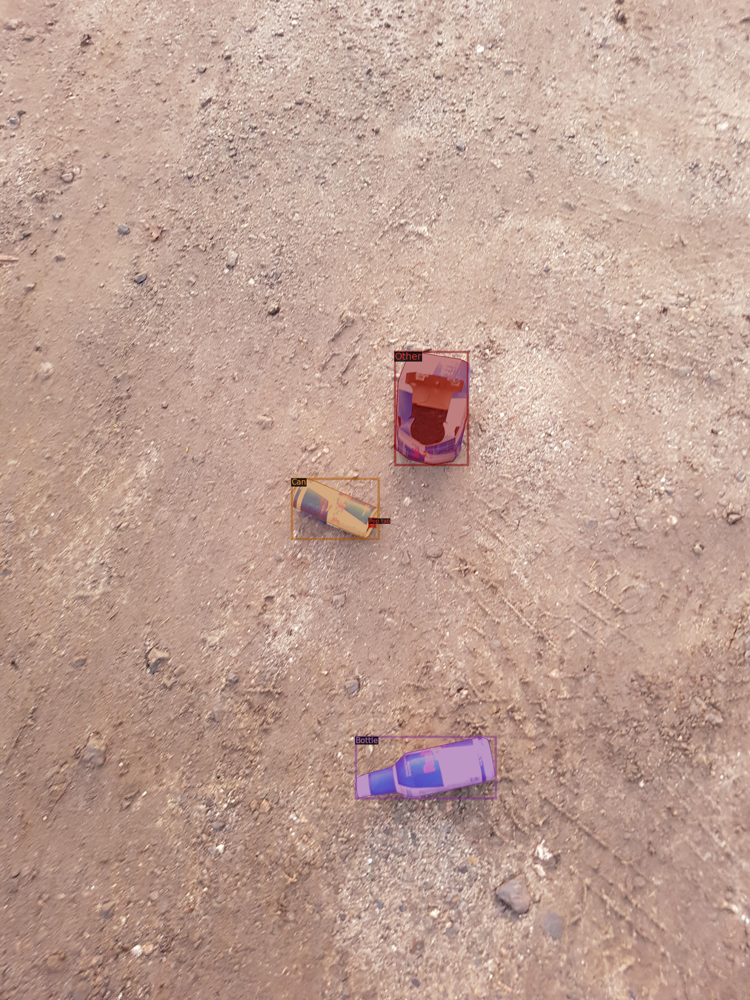

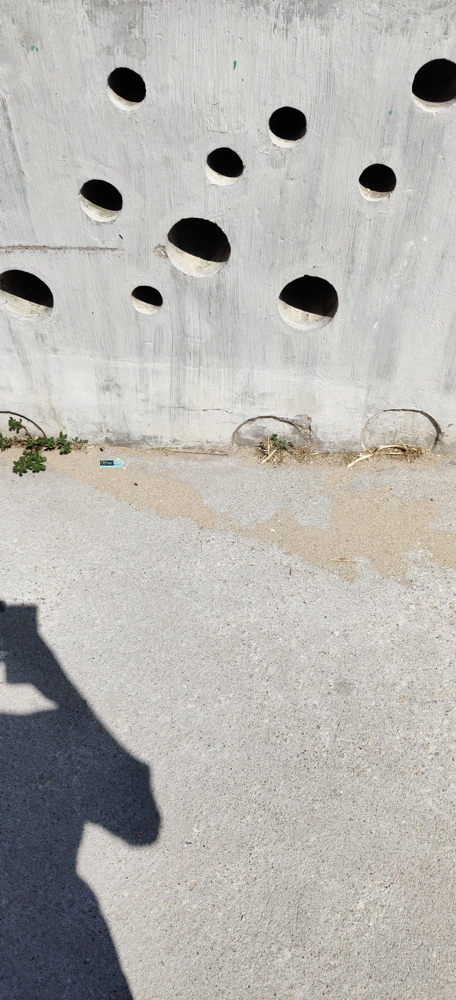

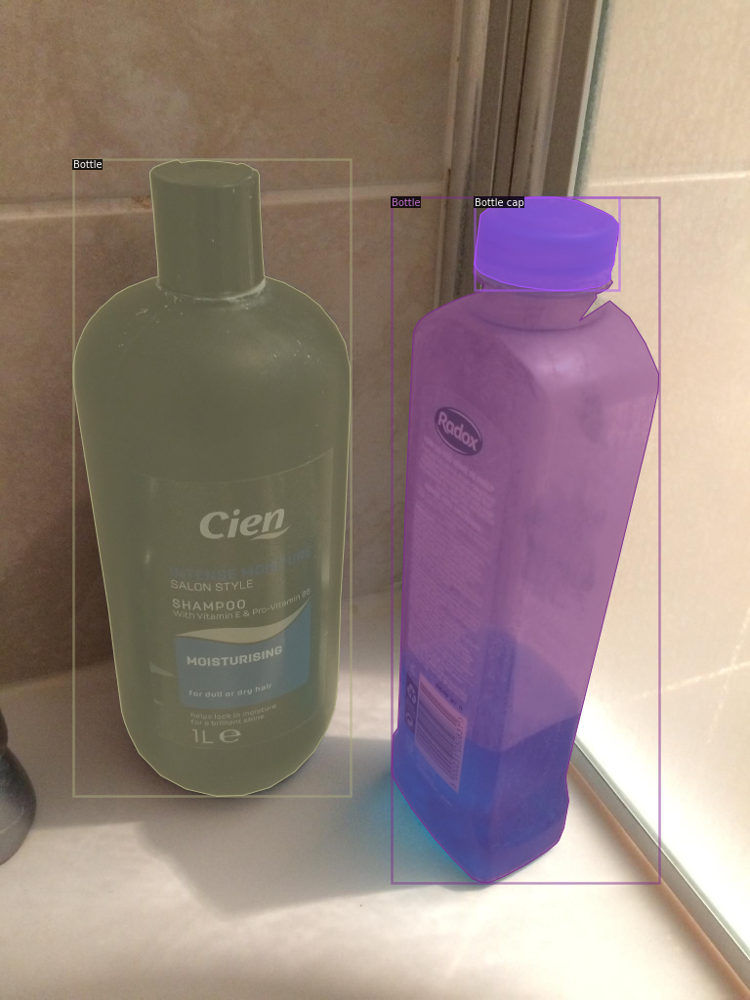

In [ ]:
TACO_10_metadata = MetadataCatalog.get("TACO_10_train")
dataset_dicts = get_TACO_10_dicts("data","annotations_0_train.json")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=TACO_10_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

Realizamos la configuración de la red de igual forma que para TACO-1. 

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")) # Se define el backbone a utilizar
cfg.DATASETS.TRAIN = ("TACO_10_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Se cargan los pesos pre-entrenados de COCO
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001  # learning rate
cfg.SOLVER.MAX_ITER = 2000    # Se define el número de épocas
cfg.SOLVER.STEPS = []  
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # Usamos 512 regiones propuestas por imagen
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 10  # Configuramos el numero de clases en 10


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[07/01 16:54:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (11, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (11,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (40, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (40,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (10, 256, 1, 

[07/01 16:54:52 d2.engine.train_loop]: Starting training from iteration 0
[07/01 16:55:23 d2.utils.events]:  eta: 0:51:12  iter: 19  total_loss: 3.609  loss_cls: 2.449  loss_box_reg: 0.1851  loss_mask: 0.6921  loss_rpn_cls: 0.149  loss_rpn_loc: 0.01172  time: 1.5090  data_time: 0.0790  lr: 1.9981e-05  max_mem: 6652M
[07/01 16:55:53 d2.utils.events]:  eta: 0:49:16  iter: 39  total_loss: 2.895  loss_cls: 1.698  loss_box_reg: 0.167  loss_mask: 0.6838  loss_rpn_cls: 0.1205  loss_rpn_loc: 0.02147  time: 1.4918  data_time: 0.0084  lr: 3.9961e-05  max_mem: 6696M
[07/01 16:56:23 d2.utils.events]:  eta: 0:49:37  iter: 59  total_loss: 1.65  loss_cls: 0.7527  loss_box_reg: 0.1352  loss_mask: 0.666  loss_rpn_cls: 0.05063  loss_rpn_loc: 0.009862  time: 1.4954  data_time: 0.0109  lr: 5.9941e-05  max_mem: 6696M
[07/01 16:56:54 d2.utils.events]:  eta: 0:49:16  iter: 79  total_loss: 1.103  loss_cls: 0.2267  loss_box_reg: 0.1181  loss_mask: 0.6255  loss_rpn_cls: 0.07366  loss_rpn_loc: 0.01912  time: 1.5

In [ ]:
# Métricas obtenidas del modelo usando el utilitario tensorboard
%load_ext tensorboard
%tensorboard --logdir output

Configuración del modelo para realizar predicciones sobre los datos de prueba

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # ruta al modelo entrenado
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3   # configuración del límite inferior de detección
predictor = DefaultPredictor(cfg)

Se prueba la predicción del modelo sobre tres imagenes aleatorias del conjunto de pruebas

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_TACO_filenames("data")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d)
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=TACO_10_metadata, 
                   scale=0.5,  
                   instance_mode=ColorMode.IMAGE_BW  
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

Finalmente, usamos la función `COCOEvaluator()` para obtener las métricas establecidas tanto del modelo general como por clases.



In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("TACO_10_test", ("bbox","segm"), False, output_dir="./output/") # Se definen las métricas a evaluar y el conjunto de datos a usar
val_loader = build_detection_test_loader(cfg, "TACO_10_test") # Se carga el conjunto de pruebas
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[07/01 17:44:38 d2.evaluation.coco_evaluation]: 'TACO_10_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[07/01 17:44:38 d2.data.datasets.coco]: Converting annotations of dataset 'TACO_10_test' to COCO format ...)
[07/01 17:44:38 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[07/01 17:44:39 d2.data.datasets.coco]: Conversion finished, #images: 300, #annotations: 991
[07/01 17:44:39 d2.data.datasets.coco]: Caching COCO format annotations at './output/TACO_10_test_coco_format.json' ...
[07/01 17:44:39 d2.data.build]: Distribution of instances among all 10 categories:
|   category    | #instances   |  category  | #instances   |  category  | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|      Can      | 48           |   Other    | 348          |   Bottle   | 79           |
|  Bottle cap   | 58           |    Cup     | 45           |    Lid     | 14         